<a href="https://colab.research.google.com/github/arya8831/Starbucks-Data-Analysis/blob/main/Starbucks_Data_Analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [31]:
import numpy as np
import pandas as pd

import warnings
warnings.filterwarnings('ignore')

from google.colab import data_table
data_table.enable_dataframe_formatter()

import matplotlib
import matplotlib.pyplot as plt
import matplotlib.ticker as mticker
import matplotlib.dates as mdates
import matplotlib.colors as mcolors
from matplotlib import style
import seaborn as sns
sns.set_style('whitegrid')
plt.style.use("fivethirtyeight")
%matplotlib inline

# For reading stock data from yahoo
from pandas_datareader.data import DataReader

# For time stamps
from datetime import datetime
from math import sqrt

#ignore the warnings
import warnings
warnings.filterwarnings('ignore')


try:
    import mplfinance as mpf
    import mpl_finance as mplf
    from mpl_finance import candlestick_ohlc
except:
    !pip install mplfinance mpl_finance
    import mplfinance as mpf
    import mpl_finance as mplf
    from mpl_finance import candlestick_ohlc

import plotly.graph_objects as go

In [32]:
from google.colab import files
uploaded=files.upload()

Saving Starbucks_stock_action.csv to Starbucks_stock_action (2).csv
Saving Starbucks_stock_history.csv to Starbucks_stock_history (2).csv
Saving Starbucks_stock_info.csv to Starbucks_stock_info (2).csv


**STARBUCKS STOCKS**

In [33]:
sbks_stock_action=pd.read_csv('Starbucks_stock_action.csv')
sbks_stock_action

,Date,Dividends,Stock Splits
0,1993-09-30,0.000,2.0
1,1995-12-04,0.000,2.0
2,1999-03-22,0.000,2.0
3,2001-04-30,0.000,2.0
4,2005-10-24,0.000,2.0
5,2010-04-05,0.050,0.0
6,2010-08-02,0.065,0.0
7,2010-11-16,0.065,0.0
8,2011-02-07,0.065,0.0
9,2011-05-09,0.065,0.0


In [34]:
sbks_stock_history=pd.read_csv('Starbucks_stock_history.csv')
sbks_stock_history

,Date,Open,High,Low,Close,Volume,Dividends,Stock Splits
0,1992-06-26,0.270957,0.287086,0.264507,0.277409,224358400,0.0,0.0
1,1992-06-29,0.280635,0.303215,0.274183,0.296763,58732800,0.0,0.0
2,1992-06-30,0.303215,0.306440,0.283860,0.287086,34777600,0.0,0.0
3,1992-07-01,0.290312,0.296763,0.280635,0.293538,18316800,0.0,0.0
4,1992-07-02,0.296763,0.296763,0.287086,0.293538,13996800,0.0,0.0
...,...,...,...,...,...,...,...,...
7367,2021-09-27,113.610001,114.669998,112.910004,113.680000,3988800,0.0,0.0
7368,2021-09-28,112.680000,113.000000,111.080002,111.709999,5917700,0.0,0.0
7369,2021-09-29,111.900002,112.519997,111.570000,112.169998,4389100,0.0,0.0
7370,2021-09-30,111.519997,112.160004,110.309998,110.309998,5974500,0.0,0.0


In [35]:
sbux = pd.read_csv('Starbucks_stock_history.csv')
sbux_info =  pd.read_csv('Starbucks_stock_info.csv',
                         header=None,
                         names=(['Description','Information']))
#sbux_info.dropna()
sbux_info.drop(sbux_info.loc[sbux_info['Information']=='nan'].index, inplace=True)
s = sbux_info.sort_values('Information').style
s

,Description,Information
48,gmtOffSetMilliseconds,-14400000
65,bookValue,-5.768
76,heldPercentInsiders,0.00169
99,shortPercentOfFloat,0.0093
67,sharesPercentSharesOut,0.0093
107,trailingAnnualDividendYield,0.01631765
146,dividendYield,0.0174
28,returnOnAssets,0.0845
14,profitMargins,0.104270004
18,operatingMargins,0.14613


Text(0, 0.5, 'Stock Price')

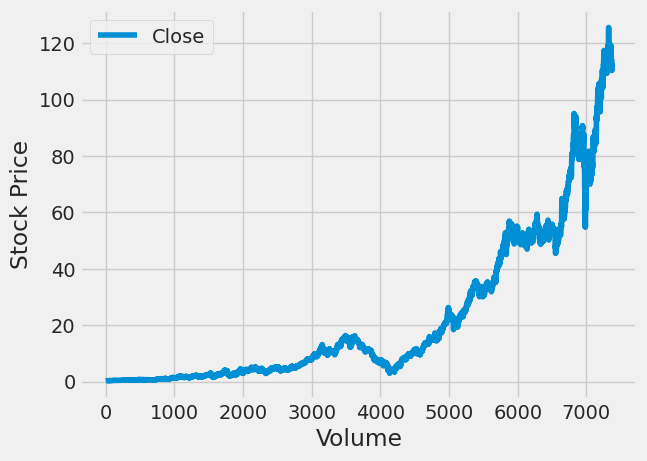

In [36]:
#Closing Price PLot
sbux[["Close"]].plot()
plt.xlabel('Volume')
plt.ylabel('Stock Price')

Text(0.5, 0, 'Volume')

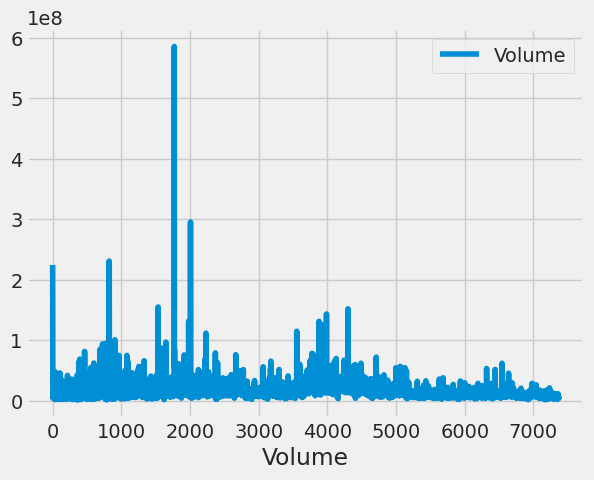

In [37]:
#Volume Plot
sbux[["Volume"]].plot()
plt.xlabel('Volume')

In [38]:
sbux2 = pd.read_csv('Starbucks_stock_history.csv', header=0,
                  index_col= 0, names=['Date','Open', 'High', 'Low', 'Close', 'Volume', 'Dividends', 'Splits'], parse_dates=True)
# Get the number of days in `sbux`
days = (sbux2.index[-1] - sbux2.index[0]).days

# Calculate the CAGR
cagr = ((((sbux2['Close'][-1]) / sbux2['Close'][1])) ** (365.0/days)) - 1


# Print CAGR
print("The CAGR (Compound Annual Growth Rate) of Starbucks since IPO is " , round((cagr*100),2), "% per year")

The CAGR (Compound Annual Growth Rate) of Starbucks since IPO is  22.49 % per year


In [39]:
# Isolate the adjusted closing prices
adj_close_px = sbux2['Close']

# Calculate the moving average
moving_avg = adj_close_px.rolling(window=40).mean()

# Inspect the result
moving_avg[-10:]

Date
2021-09-20    117.387744
2021-09-21    117.053929
2021-09-22    116.742111
2021-09-23    116.547193
2021-09-24    116.352272
2021-09-27    116.170259
2021-09-28    115.965394
2021-09-29    115.802909
2021-09-30    115.615838
2021-10-01    115.474593
Name: Close, dtype: float64

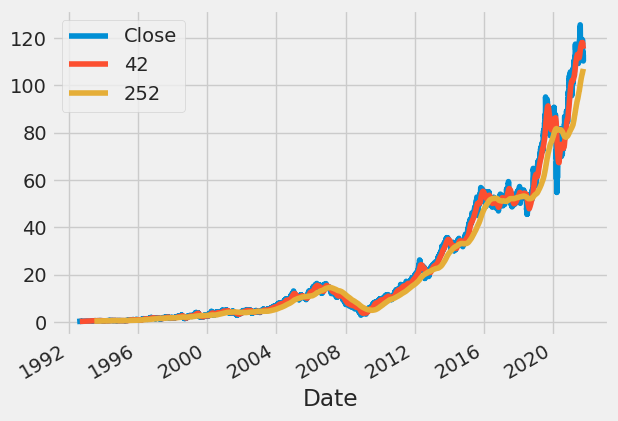

In [40]:
# Short moving window rolling mean
sbux2['42'] = adj_close_px.rolling(window=40).mean()

# Long moving window rolling mean
sbux2['252'] = adj_close_px.rolling(window=252).mean()

# Plot the adjusted closing price, the short and long windows of rolling means
sbux2[['Close', '42', '252']].plot()

plt.show()

In [41]:
fig = go.Figure(data=go.Ohlc(x=sbux['Date'],
        open=sbux['Open'],
        high=sbux['High'],
        low=sbux['Low'],
        close=sbux['Close']))
fig.show()

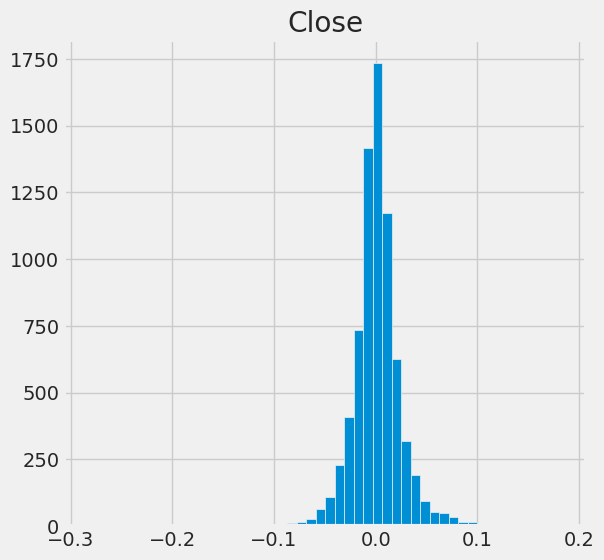

In [42]:
daily_close_px = sbux2[['Close']]
# Calculate the daily percentage change for `daily_close_px`
daily_pct_change = daily_close_px.pct_change()

# Plot the distributions
daily_pct_change.hist(bins=50, sharex=True, figsize=(6,6))

# Show the resulting plot
plt.show()

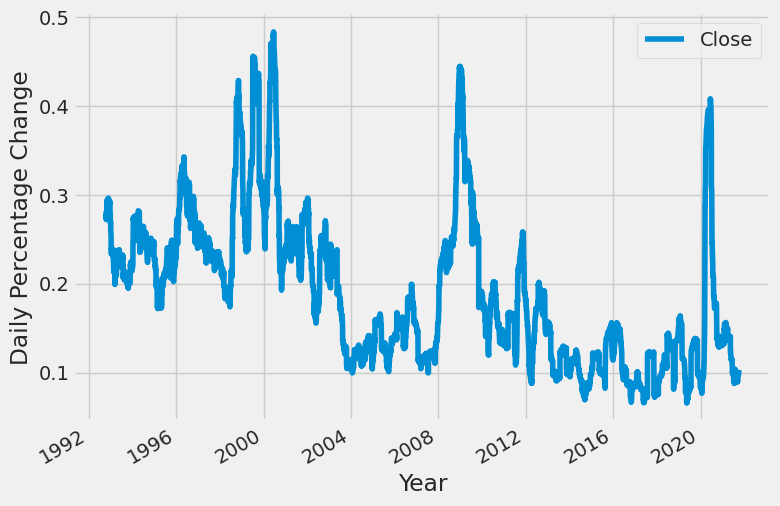

In [43]:
# Define the minumum of periods to consider
min_periods = 75

# Calculate the volatility
vol = daily_pct_change.rolling(min_periods).std() * np.sqrt(min_periods)

# Plot the volatility
vol.plot(figsize=(8, 6))
plt.xlabel('Year')
plt.ylabel('Daily Percentage Change')

# Show the plot
plt.show()

In [44]:
sbux['SMA5'] = sbux.Close.rolling(5).mean()
sbux['SMA20'] = sbux.Close.rolling(20).mean()
sbux['SMA50'] = sbux.Close.rolling(50).mean()
sbux['SMA200'] = sbux.Close.rolling(200).mean()
sbux['SMA500'] = sbux.Close.rolling(500).mean()

fig = go.Figure(data=[go.Ohlc(x=sbux['Date'],
                              open=sbux['Open'],
                              high=sbux['High'],
                              low=sbux['Low'],
                              close=sbux['Close'], name = "OHLC"),
                      go.Scatter(x=sbux.Date, y=sbux.SMA5, line=dict(color='orange', width=1), name="SMA5"),
                      go.Scatter(x=sbux.Date, y=sbux.SMA20, line=dict(color='green', width=1), name="SMA20"),
                      go.Scatter(x=sbux.Date, y=sbux.SMA50, line=dict(color='blue', width=1), name="SMA50"),
                      go.Scatter(x=sbux.Date, y=sbux.SMA200, line=dict(color='violet', width=1), name="SMA200"),
                      go.Scatter(x=sbux.Date, y=sbux.SMA500, line=dict(color='purple', width=1), name="SMA500")])
fig.show()

In [45]:
sbux['EMA5'] = sbux.Close.ewm(span=5, adjust=False).mean()
sbux['EMA20'] = sbux.Close.ewm(span=20, adjust=False).mean()
sbux['EMA50'] = sbux.Close.ewm(span=50, adjust=False).mean()
sbux['EMA200'] = sbux.Close.ewm(span=200, adjust=False).mean()
sbux['EMA500'] = sbux.Close.ewm(span=500, adjust=False).mean()

fig = go.Figure(data=[go.Ohlc(x=sbux['Date'],
                              open=sbux['Open'],
                              high=sbux['High'],
                              low=sbux['Low'],
                              close=sbux['Close'], name = "OHLC"),
                      go.Scatter(x=sbux.Date, y=sbux.SMA5, line=dict(color='orange', width=1), name="EMA5"),
                      go.Scatter(x=sbux.Date, y=sbux.SMA20, line=dict(color='green', width=1), name="EMA20"),
                      go.Scatter(x=sbux.Date, y=sbux.SMA50, line=dict(color='blue', width=1), name="EMA50"),
                      go.Scatter(x=sbux.Date, y=sbux.SMA200, line=dict(color='violet', width=1), name="EMA200"),
                      go.Scatter(x=sbux.Date, y=sbux.SMA500, line=dict(color='purple', width=1), name="EMA500")])
fig.show()

In [46]:
sbux.set_index('Date')

,Open,High,Low,Close,Volume,Dividends,Stock Splits,SMA5,SMA20,SMA50,SMA200,SMA500,EMA5,EMA20,EMA50,EMA200,EMA500
Date,,,,,,,,,,,,,,,,,
1992-06-26,0.270957,0.287086,0.264507,0.277409,224358400,0.0,0.0,NaN,NaN,NaN,NaN,NaN,0.277409,0.277409,0.277409,0.277409,0.277409
1992-06-29,0.280635,0.303215,0.274183,0.296763,58732800,0.0,0.0,NaN,NaN,NaN,NaN,NaN,0.283861,0.279252,0.278168,0.277602,0.277487
1992-06-30,0.303215,0.306440,0.283860,0.287086,34777600,0.0,0.0,NaN,NaN,NaN,NaN,NaN,0.284936,0.279999,0.278518,0.277696,0.277525
1992-07-01,0.290312,0.296763,0.280635,0.293538,18316800,0.0,0.0,NaN,NaN,NaN,NaN,NaN,0.287803,0.281288,0.279107,0.277854,0.277589
1992-07-02,0.296763,0.296763,0.287086,0.293538,13996800,0.0,0.0,0.289667,NaN,NaN,NaN,NaN,0.289714,0.282455,0.279673,0.278010,0.277652
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-09-27,113.610001,114.669998,112.910004,113.680000,3988800,0.0,0.0,113.444000,115.8435,117.220352,110.545562,92.398329,113.758481,115.115722,115.771680,109.209779,96.111184
2021-09-28,112.680000,113.000000,111.080002,111.709999,5917700,0.0,0.0,113.342000,115.6485,117.157070,110.583496,92.458641,113.075654,114.791367,115.612398,109.234657,96.173455
2021-09-29,111.900002,112.519997,111.570000,112.169998,4389100,0.0,0.0,113.162000,115.3825,117.061149,110.635536,92.517465,112.773769,114.541713,115.477402,109.263864,96.237313


In [47]:
sbux['daily_change_pct'] = sbux['Close'].pct_change()*100
sbux['returns'] = sbux['daily_change_pct'] / sbux['Close']
sbux.head()

,Date,Open,High,Low,Close,Volume,Dividends,Stock Splits,SMA5,SMA20,SMA50,SMA200,SMA500,EMA5,EMA20,EMA50,EMA200,EMA500,daily_change_pct,returns
0,1992-06-26,0.270957,0.287086,0.264507,0.277409,224358400,0.0,0.0,NaN,NaN,NaN,NaN,NaN,0.277409,0.277409,0.277409,0.277409,0.277409,NaN,NaN
1,1992-06-29,0.280635,0.303215,0.274183,0.296763,58732800,0.0,0.0,NaN,NaN,NaN,NaN,NaN,0.283861,0.279252,0.278168,0.277602,0.277487,6.976593,23.508973
2,1992-06-30,0.303215,0.306440,0.283860,0.287086,34777600,0.0,0.0,NaN,NaN,NaN,NaN,NaN,0.284936,0.279999,0.278518,0.277696,0.277525,-3.260929,-11.358728
3,1992-07-01,0.290312,0.296763,0.280635,0.293538,18316800,0.0,0.0,NaN,NaN,NaN,NaN,NaN,0.287803,0.281288,0.279107,0.277854,0.277589,2.247327,7.656012
4,1992-07-02,0.296763,0.296763,0.287086,0.293538,13996800,0.0,0.0,0.289667,NaN,NaN,NaN,NaN,0.289714,0.282455,0.279673,0.278010,0.277652,0.000000,0.000000


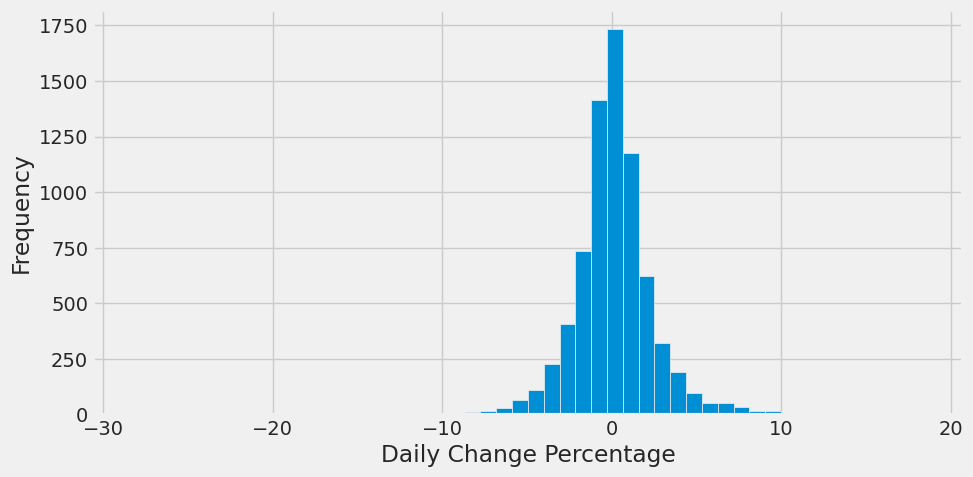

count    7371.000000
mean        0.110378
std         2.402645
min       -28.286205
25%        -1.039634
50%         0.000000
75%         1.139283
max        18.379875
Name: daily_change_pct, dtype: float64

In [48]:
sbux['daily_change_pct'].fillna(0)
sbux['daily_change_pct'].hist(bins = 50, figsize = (10,5))
plt.xlabel('Daily Change Percentage')
plt.ylabel('Frequency')
plt.show()
#print the statistics on daily change percentage
sbux.daily_change_pct.describe()

Text(0.5, 1.0, '7-day rolling averages for volume of stocks traded')

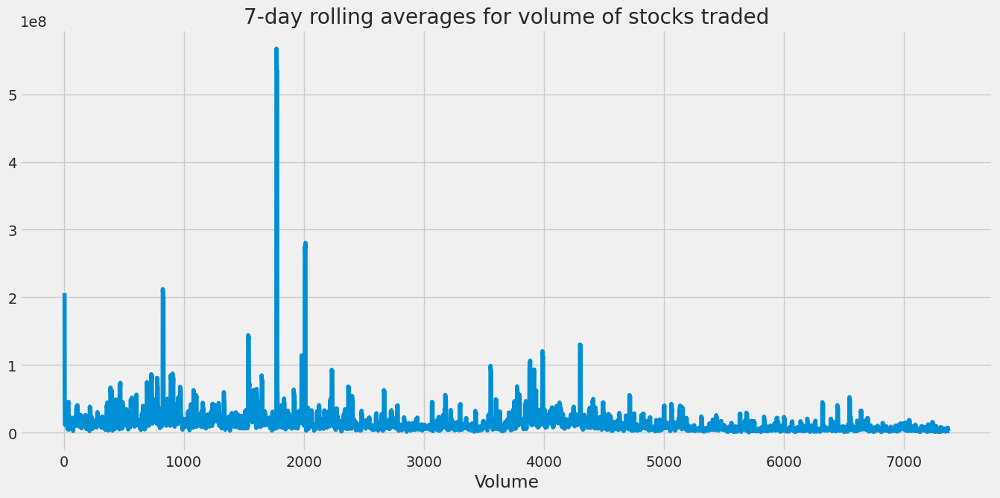

In [49]:
sbux_vol = sbux['Volume'].rolling(7).std()*np.sqrt(7)
sbux_vol.plot(figsize = (15, 7))
plt.xlabel('Volume')
plt.title('7-day rolling averages for volume of stocks traded')

In [50]:
def daily_trend(x):
    if x > -0.5 and x <= 0.5:
        return 'No change'
    elif x > 0.5 and x <= 2:
        return 'Upto 2% Increase'
    elif x > -2 and x <= -0.5:
        return 'Upto 2% Decrease'
    elif x > 2 and x <= 5:
        return '2-5% Increase'
    elif x > -5 and x <= -2:
        return '2-5% Decrease'
    elif x > 5 and x <= 10:
        return '5-10% Increase'
    elif x > -10 and x <= -5:
        return '5-10% Decrease'
    elif x > 10:
        return '>10% Increase'
    elif x <= -10:
        return '>10% Decrease'

In [51]:
sbux['Trend']= np.zeros(sbux['daily_change_pct'].count()+1)
sbux['Trend']= sbux['daily_change_pct'].apply(lambda x:daily_trend(x))
sbux['Trend'].replace('None','No change')
sbux.head()

,Date,Open,High,Low,Close,Volume,Dividends,Stock Splits,SMA5,SMA20,...,SMA200,SMA500,EMA5,EMA20,EMA50,EMA200,EMA500,daily_change_pct,returns,Trend
0,1992-06-26,0.270957,0.287086,0.264507,0.277409,224358400,0.0,0.0,NaN,NaN,...,NaN,NaN,0.277409,0.277409,0.277409,0.277409,0.277409,NaN,NaN,None
1,1992-06-29,0.280635,0.303215,0.274183,0.296763,58732800,0.0,0.0,NaN,NaN,...,NaN,NaN,0.283861,0.279252,0.278168,0.277602,0.277487,6.976593,23.508973,5-10% Increase
2,1992-06-30,0.303215,0.306440,0.283860,0.287086,34777600,0.0,0.0,NaN,NaN,...,NaN,NaN,0.284936,0.279999,0.278518,0.277696,0.277525,-3.260929,-11.358728,2-5% Decrease
3,1992-07-01,0.290312,0.296763,0.280635,0.293538,18316800,0.0,0.0,NaN,NaN,...,NaN,NaN,0.287803,0.281288,0.279107,0.277854,0.277589,2.247327,7.656012,2-5% Increase
4,1992-07-02,0.296763,0.296763,0.287086,0.293538,13996800,0.0,0.0,0.289667,NaN,...,NaN,NaN,0.289714,0.282455,0.279673,0.278010,0.277652,0.000000,0.000000,No change


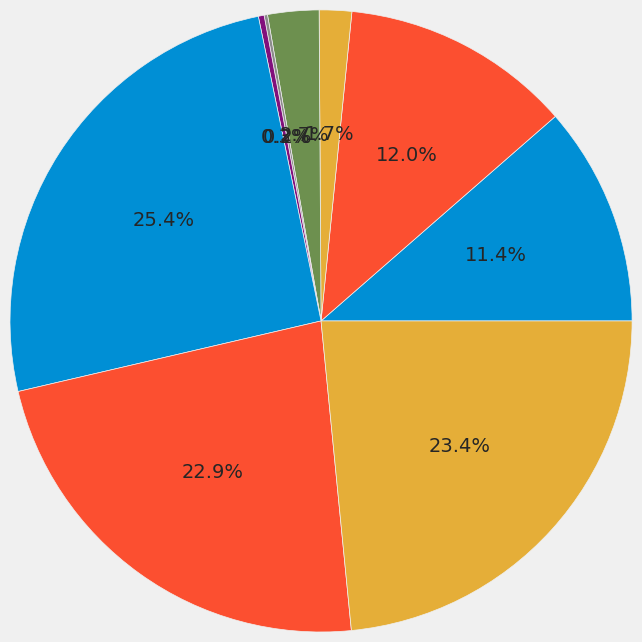

In [52]:
sbux_pie_data = sbux.groupby('Trend')
pie_label = sbux_pie_data['Trend'].unique()
plt.pie(sbux_pie_data['Trend'].count(), #labels = pie_label,
        autopct = '%1.1f%%', radius = 2 )
plt.show()

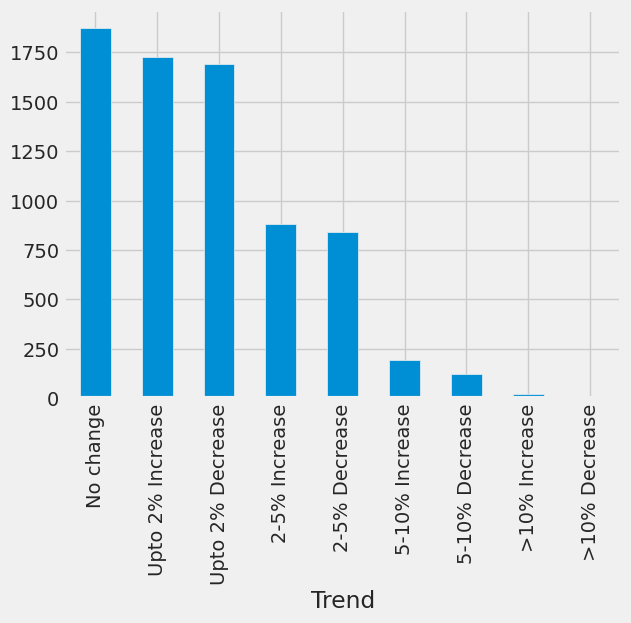

In [53]:
ax=sbux_pie_data['Trend'].count().sort_values(ascending=False).plot.bar(rot=90)
plt.show()

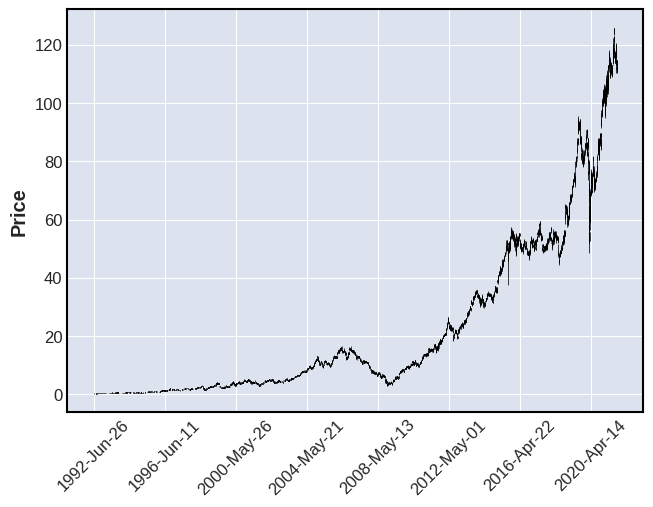

In [54]:
sbux.index = pd.DatetimeIndex(sbux['Date'])
mpf.plot(sbux)

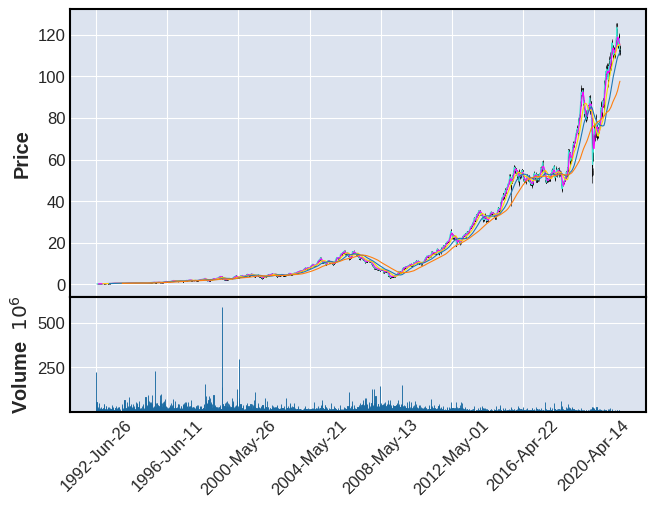

In [55]:
mpf.plot(sbux, type='candle', mav = (7, 30, 90, 180, 365), volume = True)

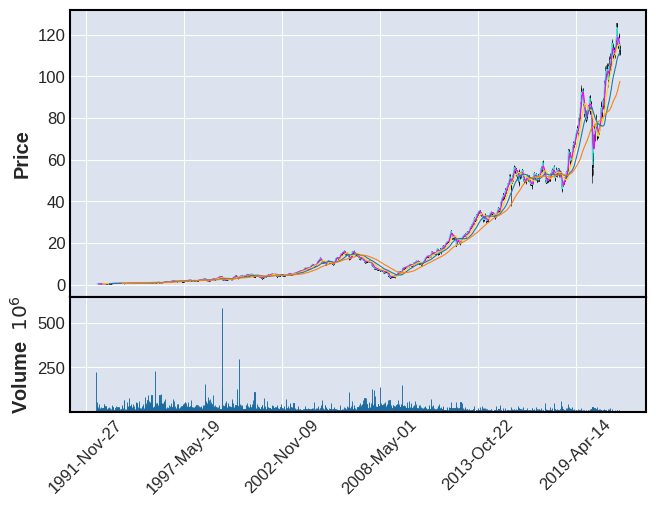

In [56]:
mpf.plot(sbux, type='candle', mav = (7, 30, 90, 180, 365), volume = True , show_nontrading = True)

In [57]:
sbux.head()

,Date,Open,High,Low,Close,Volume,Dividends,Stock Splits,SMA5,SMA20,...,SMA200,SMA500,EMA5,EMA20,EMA50,EMA200,EMA500,daily_change_pct,returns,Trend
Date,,,,,,,,,,,,,,,,,,,,,
1992-06-26,1992-06-26,0.270957,0.287086,0.264507,0.277409,224358400,0.0,0.0,NaN,NaN,...,NaN,NaN,0.277409,0.277409,0.277409,0.277409,0.277409,NaN,NaN,None
1992-06-29,1992-06-29,0.280635,0.303215,0.274183,0.296763,58732800,0.0,0.0,NaN,NaN,...,NaN,NaN,0.283861,0.279252,0.278168,0.277602,0.277487,6.976593,23.508973,5-10% Increase
1992-06-30,1992-06-30,0.303215,0.306440,0.283860,0.287086,34777600,0.0,0.0,NaN,NaN,...,NaN,NaN,0.284936,0.279999,0.278518,0.277696,0.277525,-3.260929,-11.358728,2-5% Decrease
1992-07-01,1992-07-01,0.290312,0.296763,0.280635,0.293538,18316800,0.0,0.0,NaN,NaN,...,NaN,NaN,0.287803,0.281288,0.279107,0.277854,0.277589,2.247327,7.656012,2-5% Increase
1992-07-02,1992-07-02,0.296763,0.296763,0.287086,0.293538,13996800,0.0,0.0,0.289667,NaN,...,NaN,NaN,0.289714,0.282455,0.279673,0.278010,0.277652,0.000000,0.000000,No change


In [58]:
sbux['Shares'] = [1 if sbux.loc[ei, 'SMA20']>sbux.loc[ei, 'SMA50'] else 0 for ei in sbux.index]

Text(0.5, 0, 'Year')

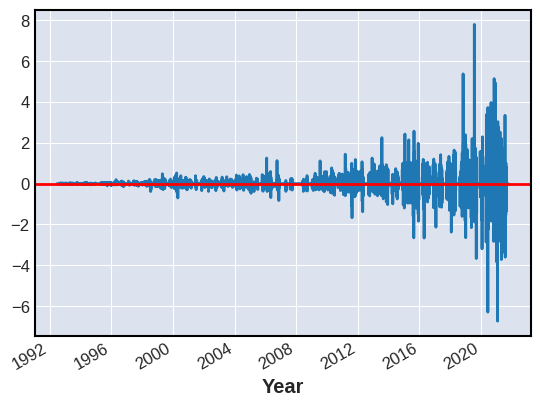

In [59]:
sbux['Close1'] = sbux['Close'].shift(-1)
sbux['Profit'] = [sbux.loc[ei, 'Close1'] - sbux.loc[ei, 'Close'] if sbux.loc[ei, 'Shares']==1 else 0 for ei in sbux.index]
sbux['Profit'].plot()
plt.axhline(y=0, color='red')
plt.xlabel('Year')

In [60]:
sbux['wealth'] = sbux['Profit'].cumsum()
sbux.tail()

,Date,Open,High,Low,Close,Volume,Dividends,Stock Splits,SMA5,SMA20,...,EMA50,EMA200,EMA500,daily_change_pct,returns,Trend,Shares,Close1,Profit,wealth
Date,,,,,,,,,,,,,,,,,,,,,
2021-09-27,2021-09-27,113.610001,114.669998,112.910004,113.680000,3988800,0.0,0.0,113.444000,115.8435,...,115.771680,109.209779,96.111184,-0.376830,-0.003315,No change,0,111.709999,0.0,108.6232
2021-09-28,2021-09-28,112.680000,113.000000,111.080002,111.709999,5917700,0.0,0.0,113.342000,115.6485,...,115.612398,109.234657,96.173455,-1.732936,-0.015513,Upto 2% Decrease,0,112.169998,0.0,108.6232
2021-09-29,2021-09-29,111.900002,112.519997,111.570000,112.169998,4389100,0.0,0.0,113.162000,115.3825,...,115.477402,109.263864,96.237313,0.411780,0.003671,No change,0,110.309998,0.0,108.6232
2021-09-30,2021-09-30,111.519997,112.160004,110.309998,110.309998,5974500,0.0,0.0,112.395999,115.0255,...,115.274759,109.274273,96.293492,-1.658198,-0.015032,Upto 2% Decrease,0,112.919998,0.0,108.6232
2021-10-01,2021-10-01,110.889999,113.459999,110.540001,112.919998,5244849,0.0,0.0,112.157999,114.8030,...,115.182415,109.310549,96.359865,2.366060,0.020953,2-5% Increase,0,NaN,0.0,108.6232


Text(0, 0.5, 'Price')

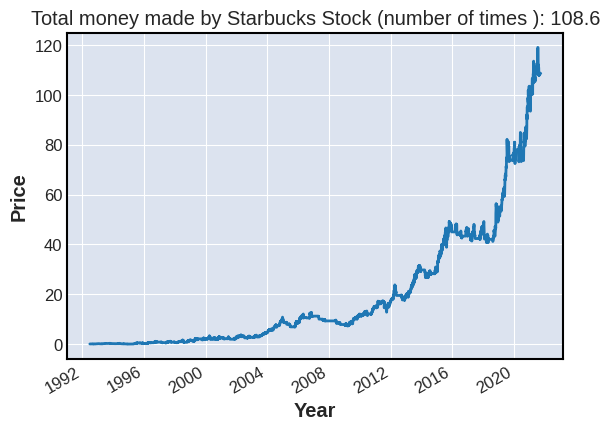

In [61]:
sbux['wealth'].plot()
plt.title('Total money made by Starbucks Stock (number of times ): {}'.format(round((sbux.loc[sbux.index[-2], 'wealth']),1)))
plt.xlabel('Year')
plt.ylabel('Price')

**STARBUCKS NUTRITION**

In [62]:
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
from sklearn.preprocessing import StandardScaler

In [63]:
from google.colab import files
uploaded=files.upload()

Saving starbucks_drinkMenu_expanded.csv to starbucks_drinkMenu_expanded.csv
Saving starbucks-menu-nutrition-drinks.csv to starbucks-menu-nutrition-drinks.csv
Saving starbucks-menu-nutrition-food.csv to starbucks-menu-nutrition-food.csv


In [64]:
starbucks_full_menu = pd.read_csv('starbucks_drinkMenu_expanded.csv')
starbucks_drinks_menu = pd.read_csv('starbucks-menu-nutrition-drinks.csv')
starbucks_food_menu = pd.read_csv('starbucks-menu-nutrition-food.csv', encoding='utf-16')

In [65]:
starbucks_full_menu = starbucks_full_menu.rename(columns={' Total Fat (g)': 'Total Fat', 'Trans Fat (g) ': 'Trans Fat',
                                            'Saturated Fat (g)': 'Saturated Fat', ' Sodium (mg)': 'Sodium',
                                            ' Total Carbohydrates (g) ': 'Total Carbohydrates',
                                            'Cholesterol (mg)': 'Cholesterol', ' Dietary Fibre (g)': 'Dietary Fibre',
                                            ' Sugars (g)': 'Sugars', ' Protein (g) ': 'Protein',
                                            'Vitamin A (% DV) ': 'Vitamin A (% DV)', ' Calcium (% DV) ': 'Calcium (% DV)',
                                            'Iron (% DV) ': 'Iron (% DV)', 'Caffeine (mg)': 'Caffeine'})

In [66]:
starbucks_full_menu['Vitamin A (% DV)'] = "0." + starbucks_full_menu['Vitamin A (% DV)']
starbucks_full_menu['Vitamin C (% DV)'] = "0." + starbucks_full_menu['Vitamin C (% DV)']
starbucks_full_menu['Calcium (% DV)'] = "0." + starbucks_full_menu['Calcium (% DV)']
starbucks_full_menu['Iron (% DV)'] = "0." + starbucks_full_menu['Iron (% DV)']

In [67]:
starbucks_full_menu = starbucks_full_menu.replace({'Vitamin A (% DV)': {'%': ''}, 'Vitamin C (% DV)': {'%': ''},
                                     'Calcium (% DV)': {'%': ''}, 'Iron (% DV)': {'%': ''}}, regex=True)

In [68]:
starbucks_full_menu = starbucks_full_menu.replace({'Iron (% DV)': {'.00': ''}}, regex=True)

In [69]:
starbucks_full_menu.loc[237, 'Total Fat'] = '3.2'

In [70]:
starbucks_full_menu = starbucks_full_menu.replace({'Caffeine': {'Varies': None, 'varies': None}})

In [71]:
columns_to_change = ['Total Fat', 'Caffeine', 'Vitamin A (% DV)', 'Vitamin C (% DV)', 'Calcium (% DV)', 'Iron (% DV)']
starbucks_full_menu[columns_to_change] = starbucks_full_menu[columns_to_change].apply(pd.to_numeric)

starbucks_drinks_menu.replace('-', '', regex=True, inplace=True)
columns_to_change = ['Calories', 'Fat (g)', 'Carb. (g)', 'Fiber (g)', 'Protein', 'Sodium']
starbucks_drinks_menu[columns_to_change] = starbucks_drinks_menu[columns_to_change].apply(pd.to_numeric)

starbucks_drinks_menu.dropna(inplace=True)
starbucks_drinks_menu = starbucks_drinks_menu[~starbucks_drinks_menu.index.duplicated()]

In [72]:
iter_imputer = IterativeImputer(missing_values=np.nan, max_iter=10, verbose=0, imputation_order='roman', random_state=24)
starbucks_full_menu_num = starbucks_full_menu.iloc[:, 3:]
imp_full_menu_num = pd.DataFrame(iter_imputer.fit_transform(starbucks_full_menu_num))
starbucks_full_menu.iloc[:, 3:] = imp_full_menu_num

In [73]:
starbucks_drinks_menu = pd.read_csv('starbucks_drinkMenu_expanded.csv')
calories = starbucks_drinks_menu.sort_values('Calories', ascending=False)
calories

,Beverage_category,Beverage,Beverage_prep,Calories,Total Fat (g),Trans Fat (g),Saturated Fat (g),Sodium (mg),Total Carbohydrates (g),Cholesterol (mg),Dietary Fibre (g),Sugars (g),Protein (g),Vitamin A (% DV),Vitamin C (% DV),Calcium (% DV),Iron (% DV),Caffeine (mg)
84,Signature Espresso Drinks,White Chocolate Mocha (Without Whipped Cream),2% Milk,510,15,9.0,0.2,35,330,77,0,74,19.0,20%,4%,60%,2%,150
215,Frappuccino® Blended Coffee,Java Chip (Without Whipped Cream),Whole Milk,460,10,7.0,0.2,15,340,90,2,84,7.0,6%,0%,15%,35%,145
85,Signature Espresso Drinks,White Chocolate Mocha (Without Whipped Cream),Soymilk,460,13,6.0,0.0,5,290,70,1,64,16.0,15%,2%,60%,20%,150
83,Signature Espresso Drinks,White Chocolate Mocha (Without Whipped Cream),Venti Nonfat Milk,450,7,6.0,0.0,10,310,78,0,74,19.0,25%,2%,60%,2%,150
128,Tazo® Tea Drinks,Tazo® Green Tea Latte,2% Milk,450,10,5.0,0.3,40,230,72,2,71,17.0,25%,20%,50%,6%,110
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,Coffee,Brewed Coffee,Short,3,0.1,0.0,0.0,0,5,0,0,0,0.3,0%,0%,0%,0%,175
105,Tazo® Tea Drinks,Tazo® Tea,Venti,0,0,0.0,0.0,0,0,0,0,0,0.0,0%,0%,0%,0%,Varies
104,Tazo® Tea Drinks,Tazo® Tea,Grande,0,0,0.0,0.0,0,0,0,0,0,0.0,0%,0%,0%,0%,Varies
103,Tazo® Tea Drinks,Tazo® Tea,Tall,0,0,0.0,0.0,0,0,0,0,0,0.0,0%,0%,0%,0%,Varies


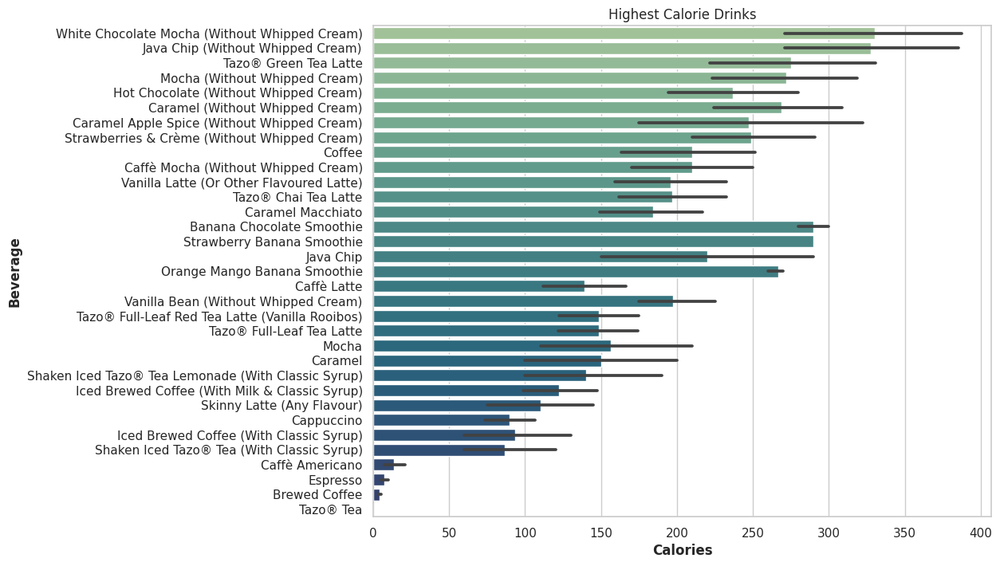

In [74]:
plt.figure(figsize=(10, 8))
sns.set_theme(style='whitegrid')
plot = sns.barplot(data=calories, x='Calories', y='Beverage', palette='crest')
plot.set(title='Highest Calorie Drinks', xlabel='Calories')
plt.xticks(rotation=0)
plt.show()

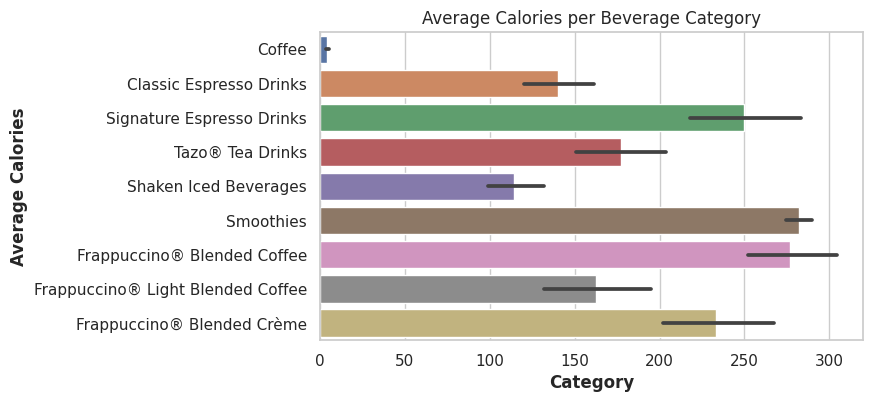

In [75]:
plt.figure(figsize=(7,4))
plot = sns.barplot(x=starbucks_drinks_menu['Calories'], y=starbucks_drinks_menu['Beverage_category']).set(xlabel='Category', ylabel='Average Calories', title='Average Calories per Beverage Category')
plt.xticks(rotation=0)
plt.show()

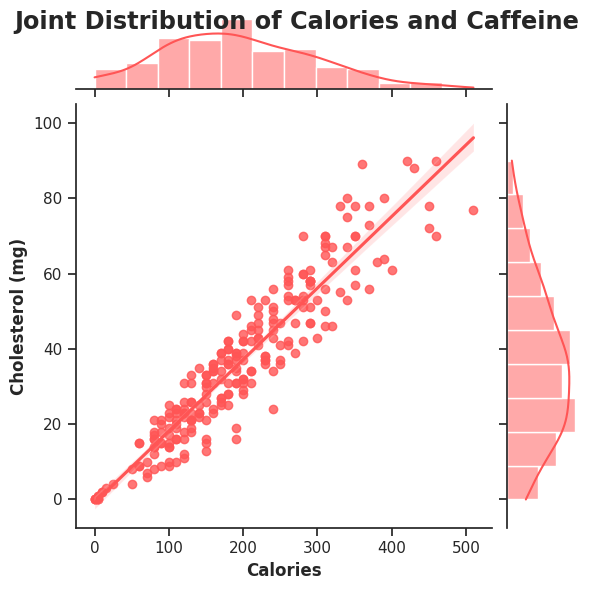

In [76]:
sns.set_theme(style='ticks')
sns.jointplot(data=calories, x='Calories', y='Cholesterol (mg)', kind='reg', color='#ff5555').fig.suptitle('Joint Distribution of Calories and Caffeine')
plt.show()

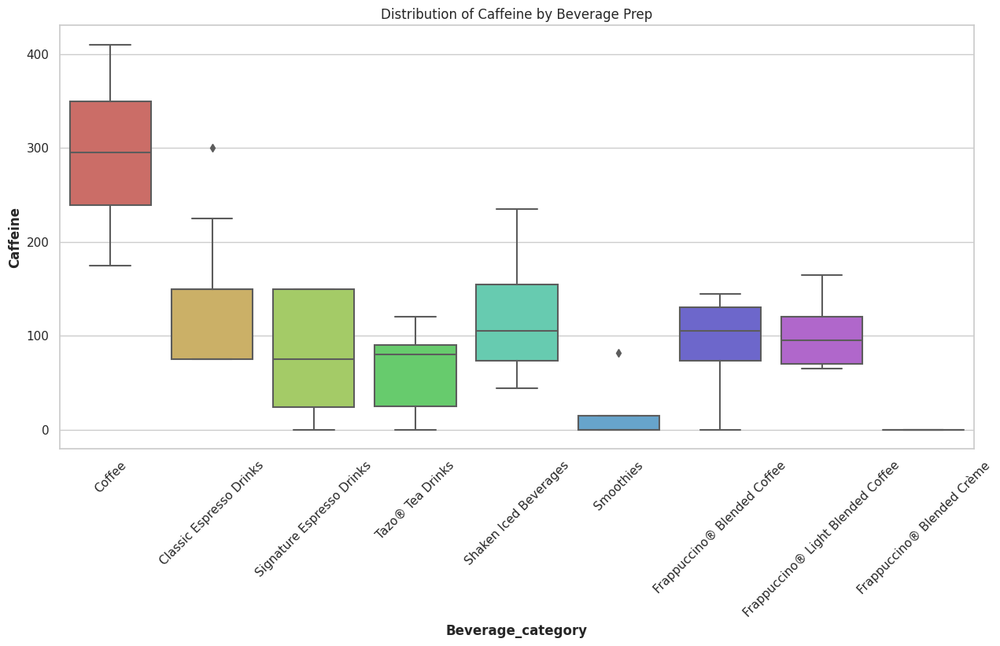

In [77]:
plt.figure(figsize=(15,7))
sns.set_theme(style='whitegrid')
sns.boxplot(data=starbucks_full_menu, x='Beverage_category', y='Caffeine', palette='hls').set(title='Distribution of Caffeine by Beverage Prep')
plt.xticks(rotation=45)
plt.show()

In [78]:
starbucks_food_menu = pd.read_csv('starbucks-menu-nutrition-food.csv', encoding='utf-16')
top20_cal = starbucks_food_menu.sort_values(' Calories', ascending=False).head(20)
top20_cal

,Unnamed: 0,Calories,Fat (g),Carb. (g),Fiber (g),Protein (g)
102,Lentils & Vegetable Protein Bowl with Brown Rice,650,29.0,80,21,23
61,Green Goddess Avocado Salad,620,37.0,62,10,13
54,Strawberries & Jam Sandwich,600,25.0,80,10,19
65,Roasted Turkey & Dill Havarti Sandwich,600,32.0,47,6,32
70,Za'atar Chicken & Lemon Tahini Salad,570,23.0,67,11,27
105,Turkey Pesto Panini,560,23.0,55,3,34
69,Turkey & Fire-Roasted Corn Salad,560,29.0,53,7,24
66,Seared Steak & Cheddar Sandwich,530,29.0,44,2,23
75,PB&J Protein Box,520,26.0,53,5,20
97,Chicken Artichoke on Ancient Grain Flatbread,510,27.0,37,5,24


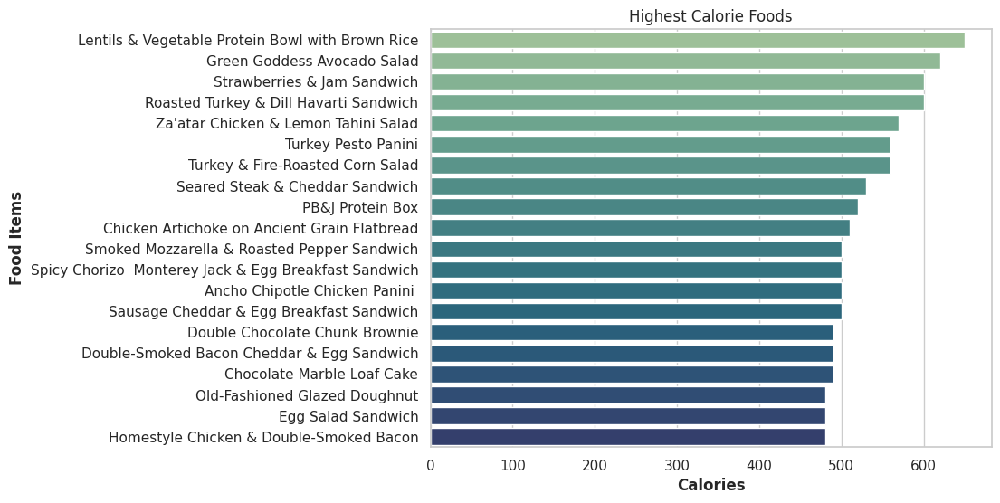

In [79]:
plt.figure(figsize=(8, 6))
sns.set_theme(style='whitegrid')
plot = sns.barplot(data=top20_cal, y='Unnamed: 0', x=' Calories', palette='crest')
plot.set(title='Highest Calorie Foods', xlabel='Calories', ylabel='Food Items')
plt.xticks(rotation=0)
plt.show()

**CONSUMER DATA**

In [80]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import seaborn as sns
# plt.style.use('fivethirtyeight')
# sns.set()

from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn import metrics

from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsClassifier
# from sklearn.decomposition import PCA

In [81]:
from google.colab import files
uploaded=files.upload()

Saving portfolio.csv to portfolio.csv
Saving profile.csv to profile.csv
Saving transcript.csv to transcript.csv


In [82]:
df_offer = pd.read_csv('portfolio.csv')
df_offer.head()

,Unnamed: 0,reward,channels,difficulty,duration,offer_type,id
0,0,10,"['email', 'mobile', 'social']",10,7,bogo,ae264e3637204a6fb9bb56bc8210ddfd
1,1,10,"['web', 'email', 'mobile', 'social']",10,5,bogo,4d5c57ea9a6940dd891ad53e9dbe8da0
2,2,0,"['web', 'email', 'mobile']",0,4,informational,3f207df678b143eea3cee63160fa8bed
3,3,5,"['web', 'email', 'mobile']",5,7,bogo,9b98b8c7a33c4b65b9aebfe6a799e6d9
4,4,5,"['web', 'email']",20,10,discount,0b1e1539f2cc45b7b9fa7c272da2e1d7


In [83]:
df_customer = pd.read_csv('profile.csv')
df_customer.head()

,Unnamed: 0,gender,age,id,became_member_on,income
0,0,NaN,118,68be06ca386d4c31939f3a4f0e3dd783,20170212,NaN
1,1,F,55,0610b486422d4921ae7d2bf64640c50b,20170715,112000.0
2,2,NaN,118,38fe809add3b4fcf9315a9694bb96ff5,20180712,NaN
3,3,F,75,78afa995795e4d85b5d9ceeca43f5fef,20170509,100000.0
4,4,NaN,118,a03223e636434f42ac4c3df47e8bac43,20170804,NaN


In [84]:
df_transcript = pd.read_csv('transcript.csv')
df_transcript.head()

,Unnamed: 0,person,event,value,time
0,0,78afa995795e4d85b5d9ceeca43f5fef,offer received,{'offer id': '9b98b8c7a33c4b65b9aebfe6a799e6d9'},0
1,1,a03223e636434f42ac4c3df47e8bac43,offer received,{'offer id': '0b1e1539f2cc45b7b9fa7c272da2e1d7'},0
2,2,e2127556f4f64592b11af22de27a7932,offer received,{'offer id': '2906b810c7d4411798c6938adc9daaa5'},0
3,3,8ec6ce2a7e7949b1bf142def7d0e0586,offer received,{'offer id': 'fafdcd668e3743c1bb461111dcafc2a4'},0
4,4,68617ca6246f4fbc85e91a2a49552598,offer received,{'offer id': '4d5c57ea9a6940dd891ad53e9dbe8da0'},0


In [85]:
df_offer = df_offer.drop('Unnamed: 0', axis = 1)
df_customer = df_customer.drop('Unnamed: 0', axis = 1)
df_transcript = df_transcript.drop('Unnamed: 0', axis = 1)

In [86]:
df_offer.isna().sum()

reward        0
channels      0
difficulty    0
duration      0
offer_type    0
id            0
dtype: int64

In [87]:
df_customer.isna().sum()

gender              2175
age                    0
id                     0
became_member_on       0
income              2175
dtype: int64

In [88]:
df_transcript.isna().sum()

person    0
event     0
value     0
time      0
dtype: int64

In [89]:
missing_gender = df_customer[df_customer['gender'].isna()]
missing_income = df_customer[df_customer['income'].isna()]

np.sum(missing_gender['id'] == missing_income['id'])

2175

In [90]:
id_to_remove = missing_income['id']
df_customer_no_na = df_customer[~df_customer['id'].isin(id_to_remove)]
df_customer_no_na = df_customer_no_na.reset_index(drop = True)
df_customer_no_na.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14825 entries, 0 to 14824
Data columns (total 5 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   gender            14825 non-null  object 
 1   age               14825 non-null  int64  
 2   id                14825 non-null  object 
 3   became_member_on  14825 non-null  int64  
 4   income            14825 non-null  float64
dtypes: float64(1), int64(2), object(2)
memory usage: 579.2+ KB


In [91]:
df_offer.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10 entries, 0 to 9
Data columns (total 6 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   reward      10 non-null     int64 
 1   channels    10 non-null     object
 2   difficulty  10 non-null     int64 
 3   duration    10 non-null     int64 
 4   offer_type  10 non-null     object
 5   id          10 non-null     object
dtypes: int64(3), object(3)
memory usage: 608.0+ bytes


In [92]:
channels_0 = df_offer['channels'][0]
offer_type_0 = df_offer['offer_type'][0]
id_0 = df_offer['id'][0]

print('First value in column channels:', channels_0, '  --   Data type:', type(channels_0))
print('First value in column offer_type:', offer_type_0, '  --   Data type:', type(offer_type_0))
print('First value in column id:', id_0, '  --   Data type:', type(id_0))

First value in column channels: ['email', 'mobile', 'social']   --   Data type: <class 'str'>
First value in column offer_type: bogo   --   Data type: <class 'str'>
First value in column id: ae264e3637204a6fb9bb56bc8210ddfd   --   Data type: <class 'str'>


In [93]:
df_customer_no_na.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14825 entries, 0 to 14824
Data columns (total 5 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   gender            14825 non-null  object 
 1   age               14825 non-null  int64  
 2   id                14825 non-null  object 
 3   became_member_on  14825 non-null  int64  
 4   income            14825 non-null  float64
dtypes: float64(1), int64(2), object(2)
memory usage: 579.2+ KB


In [94]:
df_customer_no_na['became_member_on'] = pd.to_datetime(df_customer_no_na['became_member_on'], format = '%Y%m%d')

In [95]:
df_transcript.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 306534 entries, 0 to 306533
Data columns (total 4 columns):
 #   Column  Non-Null Count   Dtype 
---  ------  --------------   ----- 
 0   person  306534 non-null  object
 1   event   306534 non-null  object
 2   value   306534 non-null  object
 3   time    306534 non-null  int64 
dtypes: int64(1), object(3)
memory usage: 9.4+ MB


In [96]:
# Rename column `time`
df_transcript.rename(columns = {'time' : 'hours_since_start'}, inplace = True)
df_transcript.head(1)

,person,event,value,hours_since_start
0,78afa995795e4d85b5d9ceeca43f5fef,offer received,{'offer id': '9b98b8c7a33c4b65b9aebfe6a799e6d9'},0


In [97]:
# Check data type of column `value`
type(df_transcript['value'][0])

str

In [98]:
# Sort df offers
df_offer = df_offer.sort_values(['offer_type', 'difficulty']).reset_index(drop = True)

# Add column `offer_alias`
from string import ascii_uppercase
df_offer['offer_alias'] = [ascii_uppercase[i] for i in range(df_offer.shape[0])]
df_offer

,reward,channels,difficulty,duration,offer_type,id,offer_alias
0,5,"['web', 'email', 'mobile']",5,7,bogo,9b98b8c7a33c4b65b9aebfe6a799e6d9,A
1,5,"['web', 'email', 'mobile', 'social']",5,5,bogo,f19421c1d4aa40978ebb69ca19b0e20d,B
2,10,"['email', 'mobile', 'social']",10,7,bogo,ae264e3637204a6fb9bb56bc8210ddfd,C
3,10,"['web', 'email', 'mobile', 'social']",10,5,bogo,4d5c57ea9a6940dd891ad53e9dbe8da0,D
4,3,"['web', 'email', 'mobile', 'social']",7,7,discount,2298d6c36e964ae4a3e7e9706d1fb8c2,E
5,2,"['web', 'email', 'mobile', 'social']",10,10,discount,fafdcd668e3743c1bb461111dcafc2a4,F
6,2,"['web', 'email', 'mobile']",10,7,discount,2906b810c7d4411798c6938adc9daaa5,G
7,5,"['web', 'email']",20,10,discount,0b1e1539f2cc45b7b9fa7c272da2e1d7,H
8,0,"['web', 'email', 'mobile']",0,4,informational,3f207df678b143eea3cee63160fa8bed,I
9,0,"['email', 'mobile', 'social']",0,3,informational,5a8bc65990b245e5a138643cd4eb9837,J


In [99]:
# Elements in value_columns are strings. Convert them to dictionaries
value_column = df_transcript['value']
value_column = value_column.apply(eval)
value_column[:3]

0    {'offer id': '9b98b8c7a33c4b65b9aebfe6a799e6d9'}
1    {'offer id': '0b1e1539f2cc45b7b9fa7c272da2e1d7'}
2    {'offer id': '2906b810c7d4411798c6938adc9daaa5'}
Name: value, dtype: object

In [100]:
# Extract the keys
dictionary_key_column = [list(d.keys())[0] for d in value_column]
# Extract the values
dictionary_value_column = [list(d.values())[0] for d in value_column]
# Create a df containing the keys and values of the dictionary elements of `value_column`
value_column_split = pd.DataFrame(columns = ['dict_key', 'dict_value'])
value_column_split['dict_key'] = dictionary_key_column
value_column_split['dict_value'] = dictionary_value_column
value_column_split.head(3)

,dict_key,dict_value
0,offer id,9b98b8c7a33c4b65b9aebfe6a799e6d9
1,offer id,0b1e1539f2cc45b7b9fa7c272da2e1d7
2,offer id,2906b810c7d4411798c6938adc9daaa5


In [101]:
# Replace `value` column with df `value_column_split`
df_transcript_value_mod = df_transcript.drop('value', axis = 1)
df_transcript_value_mod = pd.concat([df_transcript_value_mod, value_column_split], axis = 1)

In [102]:
# Reorder columns
df_transcript_value_mod.columns.values

array(['person', 'event', 'hours_since_start', 'dict_key', 'dict_value'],
      dtype=object)

In [103]:
col_names = ['person', 'event', 'dict_key', 'dict_value', 'hours_since_start']
df_transcript_value_mod = df_transcript_value_mod[col_names]
df_transcript_value_mod.sample(3)

,person,event,dict_key,dict_value,hours_since_start
192114,940cc540a67f4ddfbe25146a2a71355f,offer viewed,offer id,9b98b8c7a33c4b65b9aebfe6a799e6d9,468
85703,7ffbb6f34b834970966214e754b5a35a,transaction,amount,3.95,216
466,6dae9375dafb4329b4d69ebbd04fdca7,offer received,offer id,ae264e3637204a6fb9bb56bc8210ddfd,0


In [104]:
offers = df_offer.copy()
customers = df_customer_no_na.copy()
transcripts = df_transcript_value_mod.copy()

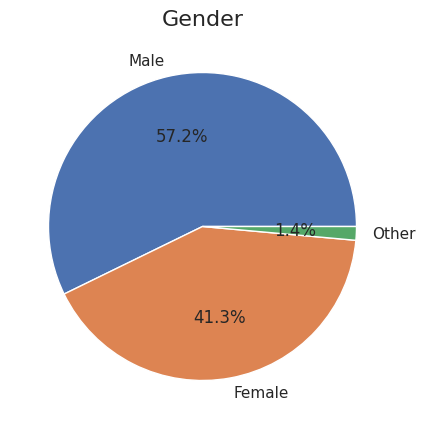

In [105]:
wedge_size =  df_customer_no_na['gender'].value_counts()
wedge_label = ['Male', 'Female', 'Other']
plt.figure(figsize = (5,5))
plt.pie(x = wedge_size, labels = wedge_label, autopct = '%1.1f%%')
plt.title('Gender', fontsize = 16)
plt.show()

count    14825.000000
mean        54.393524
std         17.383705
min         18.000000
25%         42.000000
50%         55.000000
75%         66.000000
max        101.000000
Name: age, dtype: float64


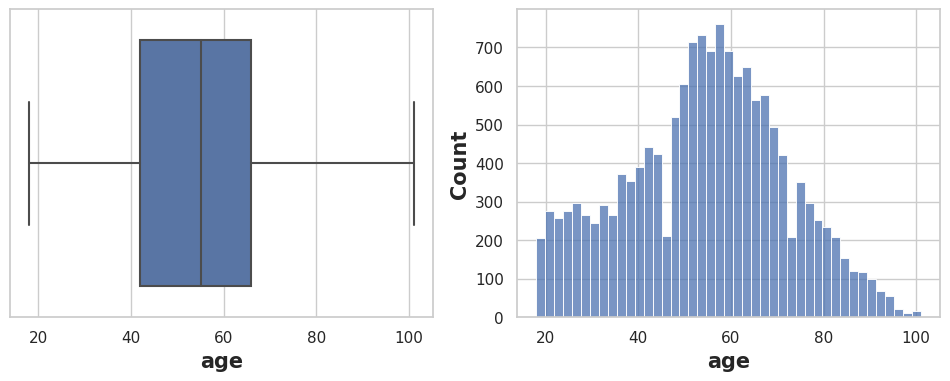

In [106]:
fig, axs = plt.subplots(1,2, figsize = (12,4))
sns.boxplot(data = customers, x = 'age', ax = axs[0])
sns.histplot(data = customers, x = 'age', ax = axs[1])
axs[0].xaxis.label.set_size(15)
axs[1].xaxis.label.set_size(15)
axs[1].yaxis.label.set_size(15)

print(customers['age'].describe())

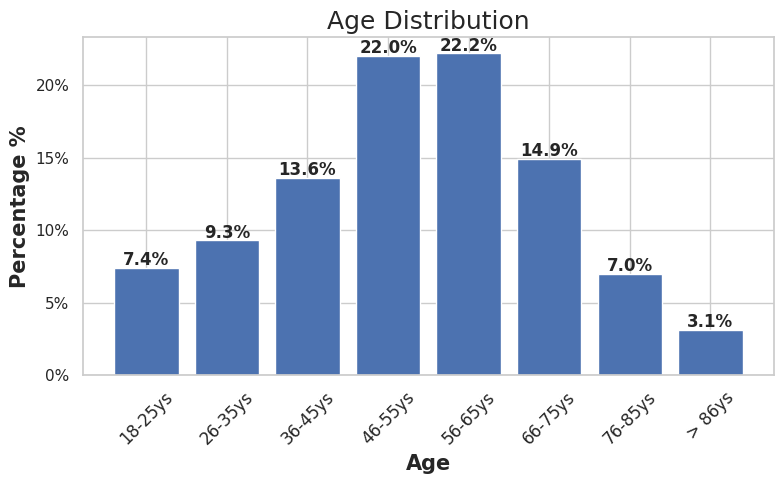

In [107]:
# Create a new column `age_group`
age_group = pd.cut(customers['age'],
      bins = [customers['age'].min(), 26, 36, 46, 56, 66, 76, 86, customers['age'].max()],
      labels = ['18-25ys', '26-35ys', '36-45ys', '46-55ys', '56-65ys', '66-75ys', '76-85ys', '> 86ys'])
customers['age_group'] = age_group

# Visualize customers by age groups
age_group_percentage = (customers.value_counts('age_group').sort_index() / customers.shape[0] * 100).round(1)
plt.figure(figsize = (8, 5))
yticks = np.arange(0,25,5)
yticklabels = [str(y) + '%' for y in yticks]
plt.yticks(yticks, labels = yticklabels)
plt.xticks(rotation = 45, fontsize = 12)
plt.xlabel('Age', fontsize = 15)
plt.ylabel('Percentage %', fontsize = 15)
plt.title('Age Distribution', fontsize = 18)

bar_plot = plt.bar(x = age_group_percentage.index.values, height = age_group_percentage)
for i,bar in enumerate(bar_plot.patches):
    x, y = bar.get_xy()
    plt.text(x+bar.get_width()/2, y+bar.get_height()+0.2,
            str(age_group_percentage[i]) + '%',
            ha = 'center', weight = 'bold')

plt.tight_layout()
plt.show()

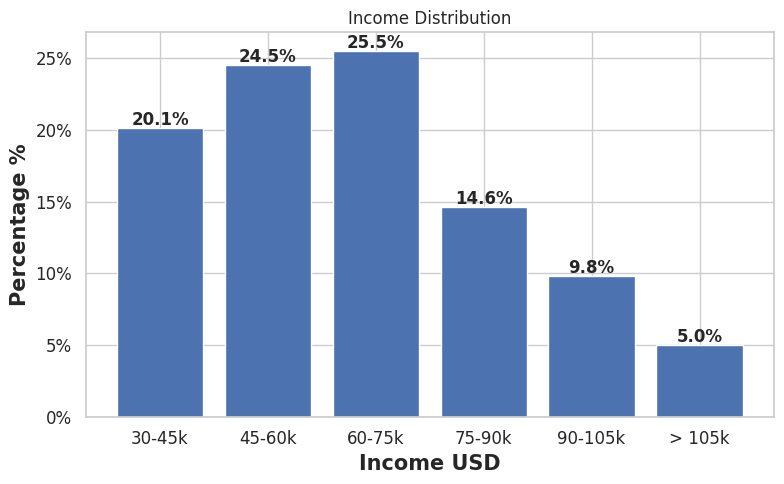

In [108]:
# Create a new column `income_group`
income_group = pd.cut(customers['income'],
      bins = [customers['income'].min(), 45000, 60000, 75000, 90000, 105000, customers['income'].max()],
      labels = ['30-45k', '45-60k', '60-75k', '75-90k', '90-105k', '> 105k'])
customers['income_group'] = income_group

# Visualize customers by income groups
income_group_percentage = (customers.value_counts('income_group').sort_index() / customers.shape[0] * 100).round(1)
plt.figure(figsize = (8, 5))
yticks = np.arange(0,30,5)
yticklabels = [str(y) + '%' for y in yticks]
plt.yticks(yticks, labels = yticklabels, fontsize = 12)
plt.xticks(fontsize = 12)
plt.xlabel('Income USD', fontsize = 15)
plt.ylabel('Percentage %', fontsize = 15)
plt.title('Income Distribution')

bar_plot = plt.bar(x = income_group_percentage.index.values, height = income_group_percentage)
for i,bar in enumerate(bar_plot.patches):
    x, y = bar.get_xy()
    plt.text(x+bar.get_width()/2, y+bar.get_height()+0.2,
            str(income_group_percentage[i]) + '%',
            ha = 'center', weight = 'bold', fontsize = 12)

plt.tight_layout()
plt.show()

              age
gender           
F       57.544950
M       52.116690
O       54.400943


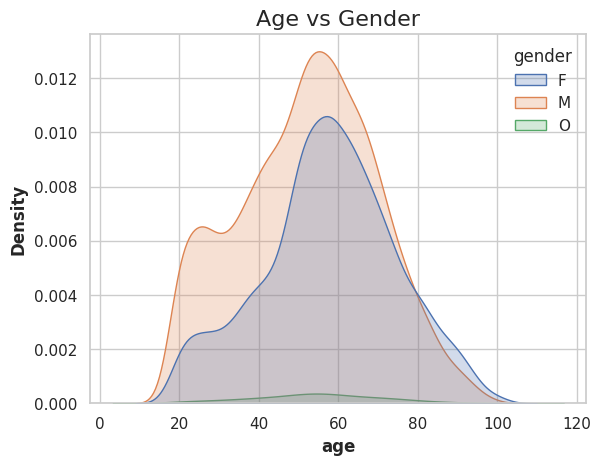

In [109]:
print(customers.groupby('gender').agg({'age': 'mean'}))
sns.kdeplot(data = customers, x = 'age', hue = 'gender', fill = True)
plt.title('Age vs Gender', fontsize = 16)
plt.show()

              income
gender              
F       71306.412139
M       61194.601603
O       63287.735849


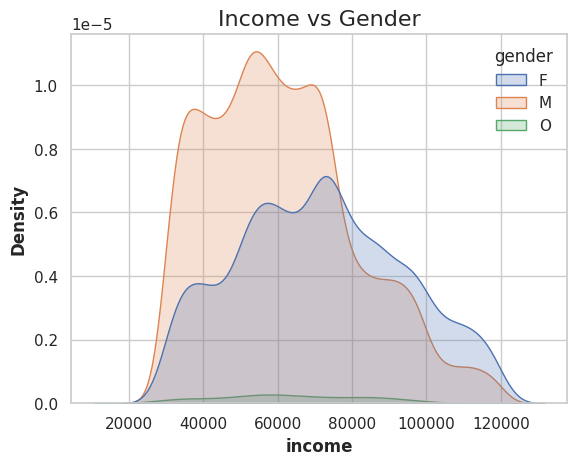

In [110]:
print(customers.groupby('gender').agg({'income': 'mean'}))
sns.kdeplot(data = customers, x = 'income', hue = 'gender', fill = True)
plt.title('Income vs Gender', fontsize = 16)
plt.show()

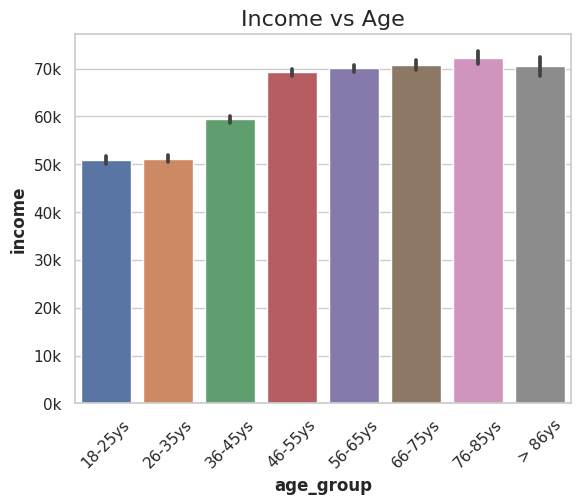

In [111]:
sns.barplot(data = customers, x = 'age_group', y = 'income')
plt.xticks(rotation = 45)
ytick_labels = [str(i) + 'k' for i in (np.arange(0, 80000, 10000) / 1000).astype(int)]
plt.yticks(np.arange(0, 80000, 10000), labels = ytick_labels)
plt.title('Income vs Age', fontsize = 16)
plt.show()

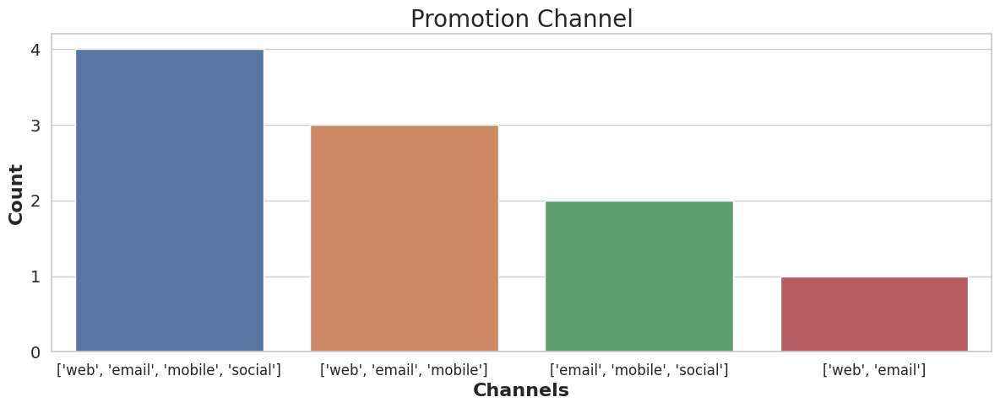

In [112]:
p = offers.value_counts('channels')
plt.figure(figsize = (12,5))
sns.barplot(x = p.index.values, y = p.values)
plt.xticks(rotation = None, fontsize = 12)
plt.yticks(np.arange(5), fontsize = 14)
plt.xlabel('Channels', fontsize = 16, fontweight = 'bold')
plt.ylabel('Count', fontsize = 16, fontweight = 'bold')
plt.title('Promotion Channel', fontsize = 20)
plt.tight_layout()
plt.show()


In [113]:
# Create an empty df with columns needed
customer_behavior = pd.DataFrame(columns = ['person', 'num_received', 'num_viewed', 'num_completed', 'num_transactions', 'money_spent'])

In [114]:
# Remove rows of customers with missing gender and income
id_to_remove = missing_income['id']
transcripts_filtered = transcripts[~transcripts['person'].isin(id_to_remove)].reset_index(drop = True)

# Add data to `person`, ordered in ascending order
customer_behavior['person'] = transcripts_filtered.value_counts('person').sort_index().index.values

In [115]:
# Aggregate df transcripts
transcripts_filtered = transcripts_filtered.sort_values('person')
transcripts_grouped = transcripts_filtered.groupby(['person', 'event']).count()
transcripts_grouped.head()

dict_key  dict_value  \
person                           event                                   
0009655768c64bdeb2e877511632db8f offer completed         3           3   
                                 offer received          5           5   
                                 offer viewed            4           4   
                                 transaction             8           8   
0011e0d4e6b944f998e987f904e8c1e5 offer completed         3           3   

                                                  hours_since_start  
person                           event                               
0009655768c64bdeb2e877511632db8f offer completed                  3  
                                 offer received                   5  
                                 offer viewed                     4  
                                 transaction                      8  
0011e0d4e6b944f998e987f904e8c1e5 offer completed                  3

In [116]:
# Set `person` as index for easy slicing
customer_behavior.set_index('person', inplace = True)

# Add data to `num_received`, `num_viewed`, `num_completed` and `num_transactions`
for person_id in customer_behavior.index.values:
    if (person_id, 'offer received') in list(transcripts_grouped.index.values):
        customer_behavior.loc[person_id, 'num_received'] = transcripts_grouped.loc[(person_id, 'offer received'), 'dict_key']
    if (person_id, 'offer viewed') in list(transcripts_grouped.index.values):
        customer_behavior.loc[person_id, 'num_viewed'] = transcripts_grouped.loc[(person_id, 'offer viewed'), 'dict_key']
    if (person_id, 'offer completed') in list(transcripts_grouped.index.values):
        customer_behavior.loc[person_id, 'num_completed'] = transcripts_grouped.loc[(person_id, 'offer completed'), 'dict_key']
    if (person_id, 'transaction') in list(transcripts_grouped.index.values):
        customer_behavior.loc[person_id, 'num_transactions'] = transcripts_grouped.loc[(person_id, 'transaction'), 'dict_key']

In [117]:
# Calculate how much money each customer spent during the month of the campaign
money_spent = transcripts_filtered[transcripts_filtered['event'] == 'transaction'].groupby('person').agg({'dict_value': 'sum'})

# Add to `money_spent`
customer_behavior['money_spent'] = money_spent
customer_behavior.head(3)

,num_received,num_viewed,num_completed,num_transactions,money_spent
person,,,,,
0009655768c64bdeb2e877511632db8f,5,4,3,8,127.6
0011e0d4e6b944f998e987f904e8c1e5,5,5,3,5,79.46
0020c2b971eb4e9188eac86d93036a77,5,3,3,8,196.86


In [118]:
customer_behavior.isna().sum()

num_received           5
num_viewed           150
num_completed       2839
num_transactions     333
money_spent          333
dtype: int64

In [119]:
# Replace NA with 0
customer_behavior.fillna(0, inplace = True)
customer_behavior.isna().sum()

num_received        0
num_viewed          0
num_completed       0
num_transactions    0
money_spent         0
dtype: int64

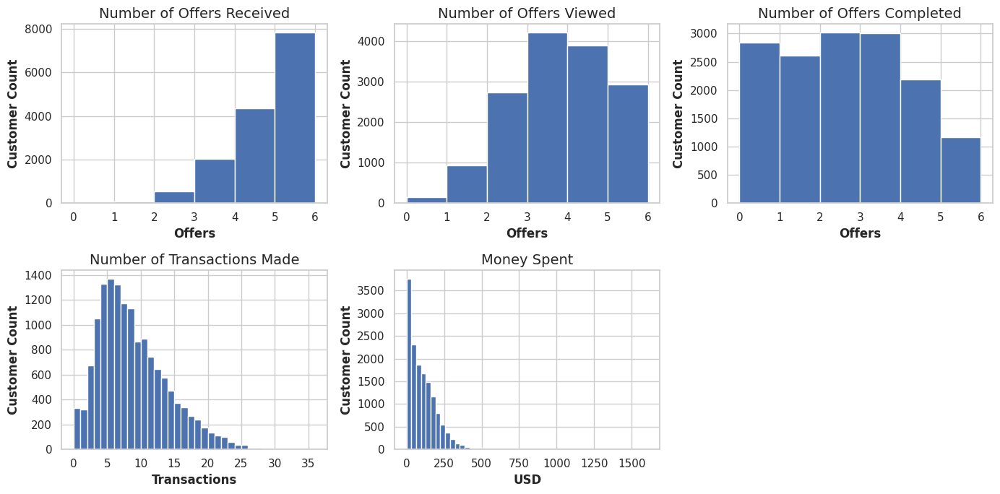

In [120]:
# Check the features with plots
fig, axs = plt.subplots(2,3, figsize = (14, 7))
fig_titles = ['Number of Offers Received', 'Number of Offers Viewed', 'Number of Offers Completed', 'Number of Transactions Made', 'Money Spent']
x_labels = ['Offers', 'Offers','Offers','Transactions','USD']
y_labels = 'Customer Count'

sub_row, sub_col = 0, 0

for i in range(5):
    if i < 3:
        sub_row = 0
        sub_col = i
        bins = customer_behavior.iloc[:, i].max()
        axs[sub_row, sub_col].hist(customer_behavior.iloc[:, i], bins = bins)
        axs[sub_row, sub_col].set_ylabel(y_labels, fontsize = 12)

    else:
        sub_row = 1
        sub_col = i - 3
        if i == 3:
            bins = customer_behavior.iloc[:, i].max()
            axs[sub_row, sub_col].hist(customer_behavior.iloc[:, i], bins = bins)
            axs[sub_row, sub_col].set_ylabel(y_labels, fontsize = 12)
        else:
            bins = 50
            axs[sub_row, sub_col].hist(customer_behavior.iloc[:, i], bins = bins)
            axs[sub_row, sub_col].set_ylabel(y_labels, fontsize = 12)

    axs[sub_row, sub_col].set_title(fig_titles[i], fontsize = 14)
    axs[sub_row, sub_col].set_xlabel(x_labels[i], fontsize = 12)

axs[1,2].set_axis_off()
plt.tight_layout()
plt.show()